In [ ]:
import numpy as np
import time
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
from torchvision import datasets, transforms
import torchvision.transforms as transforms
from torch.utils.data.sampler import SubsetRandomSampler
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader

In [ ]:
import kagglehub

path = kagglehub.dataset_download("aayush9753/image-colorization-dataset")

print("Path to dataset files:", path)

100%|██████████| 473M/473M [00:06<00:00, 76.6MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/aayush9753/image-colorization-dataset/versions/1


In [ ]:
from PIL import Image
import os

base_path = path +'/data' #'/kaggle/input/image-colorization-dataset/data'
pre_process_colour_test = os.path.join(base_path, 'test_color')
pre_process_colour_train = os.path.join(base_path, 'train_color')

pre_process_black_test = os.path.join(base_path, 'test_black')
pre_process_black_train = os.path.join(base_path, 'train_black')

processed_colour = '/tmp/colour'
processed_black = '/tmp/black'


os.makedirs(processed_colour, exist_ok=True)
os.makedirs(processed_black, exist_ok=True)

newsize = (256, 256) # <-- size stated in project proposal

for filename in os.listdir(pre_process_colour_test):
  input_path = os.path.join(pre_process_colour_test, filename)
  output_path = os.path.join(processed_colour, filename)
  img = Image.open(input_path)
  img_resized = img.resize(newsize)
  img_resized.save(output_path)

for filename in os.listdir(pre_process_colour_train):
  input_path = os.path.join(pre_process_colour_train, filename)
  output_path = os.path.join(processed_colour, filename)
  img = Image.open(input_path)
  img_resized = img.resize(newsize)
  img_resized.save(output_path)

for filename in os.listdir(pre_process_black_test):
  input_path = os.path.join(pre_process_black_test, filename)
  output_path = os.path.join(processed_black, filename)
  img = Image.open(input_path)
  img_resized = img.resize(newsize)
  img_resized.save(output_path)

for filename in os.listdir(pre_process_black_train):
  input_path = os.path.join(pre_process_black_train, filename)
  output_path = os.path.join(processed_black, filename)
  img = Image.open(input_path)
  img_resized = img.resize(newsize)
  img_resized.save(output_path)



In [ ]:
from skimage.io import imread
from skimage.color import rgb2lab, lab2rgb
import numpy as np

colour_path = '/tmp/colour'
black_path = '/tmp/black'
output_path = '/tmp/data'

os.makedirs(output_path, exist_ok=True)

for filename in os.listdir(colour_path):
  image = os.path.join(colour_path, filename)
  img = imread(image)
  img_lab = rgb2lab(img)
  L = img_lab[:, :, 0] / 100.0
  ab = img_lab[:, :, 1:] / 128.0
  base_name = os.path.splitext(filename)[0]
  save_path = os.path.join(output_path, base_name + '.npz')

        # Save
  np.savez(save_path, L=L, ab=ab)


In [ ]:
#split
import os
import shutil
from pathlib import Path

import os
import shutil
from pathlib import Path

def move_bw_and_data_files(
    black_dir, npz_dir,
    output_black_base, output_npz_base,
    split_ratio=(0.8, 0.1, 0.1)
):
    assert sum(split_ratio) == 1.0, "Split ratios must sum to 1.0"

    all_files = sorted([
        f for f in os.listdir(black_dir)
        if f.lower().endswith(('.jpg', '.jpeg', '.png'))
    ])

    total = len(all_files)
    train_end = int(split_ratio[0] * total)
    val_end = train_end + int(split_ratio[1] * total)

    splits = {
        "train": all_files[:train_end],
        "val": all_files[train_end:val_end],
        "test": all_files[val_end:]
    }

    for split_name, filenames in splits.items():
        black_out_dir = Path(output_black_base) / split_name
        npz_out_dir = Path(output_npz_base) / split_name
        black_out_dir.mkdir(parents=True, exist_ok=True)
        npz_out_dir.mkdir(parents=True, exist_ok=True)

        for fname in filenames:
            base = os.path.splitext(fname)[0]
            npz_name = base + ".npz"

            shutil.move(
                os.path.join(black_dir, fname),
                os.path.join(black_out_dir, fname)
            )

            shutil.move(
                os.path.join(npz_dir, npz_name),
                os.path.join(npz_out_dir, npz_name)
            )

        print(f"{split_name.upper()}: {len(filenames)} pairs moved to {black_out_dir} and {npz_out_dir}")

move_bw_and_data_files(
    black_dir="/tmp/black",
    npz_dir="/tmp/data",
    output_black_base="/tmp/black",
    output_npz_base="/tmp/data",
    split_ratio=(0.8, 0.1, 0.1)
)

TRAIN: 4591 pairs moved to /tmp/black/train and /tmp/data/train
VAL: 573 pairs moved to /tmp/black/val and /tmp/data/val
TEST: 575 pairs moved to /tmp/black/test and /tmp/data/test


# Baseline Model


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class ColorizationCNNTranspose(nn.Module):
    def __init__(self):
        super(ColorizationCNNTranspose, self).__init__()

        # Encoder
        self.conv1 = nn.Conv2d(1, 64, kernel_size=3, padding=1)   # (1, 224, 224) → (64, 224, 224)
        self.pool1 = nn.MaxPool2d(2, 2)                           # → (64, 112, 112)

        self.conv2 = nn.Conv2d(64, 128, kernel_size=3, padding=1) # → (128, 112, 112)
        self.pool2 = nn.MaxPool2d(2, 2)                            # → (128, 56, 56)

        self.conv3 = nn.Conv2d(128, 256, kernel_size=3, padding=1) # → (256, 56, 56)
        self.pool3 = nn.MaxPool2d(2, 2)                             # → (256, 28, 28)

        # Decoder (transpose convs)
        self.deconv1 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)  # → (128, 56, 56)
        self.deconv2 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)   # → (64, 112, 112)
        self.deconv3 = nn.ConvTranspose2d(64, 2, kernel_size=4, stride=2, padding=1)     # → (2, 224, 224)

    def forward(self, x):
        # Encoder
        x = F.relu(self.conv1(x))
        x = self.pool1(x)

        x = F.relu(self.conv2(x))
        x = self.pool2(x)

        x = F.relu(self.conv3(x))
        x = self.pool3(x)

        # Decoder
        x = F.relu(self.deconv1(x))   # Upsample to (56, 56)
        x = F.relu(self.deconv2(x))   # Upsample to (112, 112)
        x = torch.tanh(self.deconv3(x))  # Upsample to (224, 224) and output in [-1, 1]

        return x


In [ ]:
import os
import shutil
from pathlib import Path

def create_small_dataset_from_existing_splits(
    black_train_dir="/tmp/black/train",
    data_train_dir="/tmp/data/train",
    small_dataset_name="smalldataset",
    num_images=1000,
    split_ratio=(0.6, 0.2, 0.2)
):

    black_output_base = Path("/tmp/black") / small_dataset_name
    data_output_base = Path("/tmp/data") / small_dataset_name

    black_files = sorted([
        f for f in os.listdir(black_train_dir)
        if f.lower().endswith(('.jpg', '.jpeg', '.png'))
    ])[:num_images]

    data_files = sorted([
        f for f in os.listdir(data_train_dir)
        if f.lower().endswith('.npz')
    ])[:num_images]

    black_bases = {os.path.splitext(f)[0] for f in black_files}
    data_bases = {os.path.splitext(f)[0] for f in data_files}
    matching_bases = black_bases & data_bases

    black_files = [f for f in black_files if os.path.splitext(f)[0] in matching_bases][:num_images]
    data_files = [f for f in data_files if os.path.splitext(f)[0] in matching_bases][:num_images]

    total = min(len(black_files), num_images)
    train_end = int(split_ratio[0] * total)
    val_end = train_end + int(split_ratio[1] * total)

    splits = {
        "train": black_files[:train_end],
        "val": black_files[train_end:val_end],
        "test": black_files[val_end:]
    }

    for split_name, filenames in splits.items():
        black_split_dir = black_output_base / f"smalldatasetblack_{split_name}"
        data_split_dir = data_output_base / f"smalldatasetcolour_{split_name}"

        black_split_dir.mkdir(parents=True, exist_ok=True)
        data_split_dir.mkdir(parents=True, exist_ok=True)

        # Copy files
        for fname in filenames:
            base = os.path.splitext(fname)[0]
            npz_name = base + ".npz"

            shutil.copy2(
                os.path.join(black_train_dir, fname),
                os.path.join(black_split_dir, fname)
            )

            if npz_name in data_files:
                shutil.copy2(
                    os.path.join(data_train_dir, npz_name),
                    os.path.join(data_split_dir, npz_name)
                )

        print(f"Created {split_name.upper()} split with {len(filenames)} pairs")
        print(f"  Black images: {black_split_dir}")
        print(f"  Data files: {data_split_dir}\n")

create_small_dataset_from_existing_splits(
    black_train_dir="/tmp/black/train",
    data_train_dir="/tmp/data/train",
    small_dataset_name="smalldataset",
    num_images=1000,
    split_ratio=(0.6, 0.2, 0.2)
)

Created TRAIN split with 600 pairs
  Black images: /tmp/black/smalldataset/smalldatasetblack_train
  Data files: /tmp/data/smalldataset/smalldatasetcolour_train

Created VAL split with 200 pairs
  Black images: /tmp/black/smalldataset/smalldatasetblack_val
  Data files: /tmp/data/smalldataset/smalldatasetcolour_val

Created TEST split with 200 pairs
  Black images: /tmp/black/smalldataset/smalldatasetblack_test
  Data files: /tmp/data/smalldataset/smalldatasetcolour_test



In [ ]:
import time
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

def color_accuracy(pred_ab, true_ab, threshold=0.07):
    diff = torch.sqrt(torch.sum((pred_ab - true_ab)**2, dim=1))  # (B,H,W)
    return (diff < threshold).float().mean().item() * 100.0       # percent

def train_colorizer(net, batch_size=16, learning_rate=0.001, num_epochs=30):
    torch.manual_seed(1)

    train_dataset = LabColorizationDataset(
        npz_dir="/tmp/data/smalldataset/smalldatasetcolour_train"
    )
    val_dataset = LabColorizationDataset(
        npz_dir="/tmp/data/smalldataset/smalldatasetcolour_val"
    )

    train_loader = DataLoader(train_dataset, batch_size=batch_size,
                              shuffle=True,  num_workers=2, pin_memory=True)
    val_loader   = DataLoader(val_dataset,   batch_size=batch_size,
                              num_workers=2, pin_memory=True)

    criterion = nn.MSELoss()
    optimizer = optim.Adam(net.parameters(), lr=learning_rate)

    train_loss = np.zeros(num_epochs)
    val_loss   = np.zeros(num_epochs)
    train_acc  = np.zeros(num_epochs)
    val_acc    = np.zeros(num_epochs)

    start_time = time.time()
    net = net  # CPU only

    for epoch in range(num_epochs):
        # — Training —
        net.train()
        epoch_train_loss = 0.0
        epoch_train_acc  = 0.0

        for L, ab_true in train_loader:
            pred_ab = net(L)
            loss    = criterion(pred_ab, ab_true)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()

            epoch_train_loss += loss.item()
            epoch_train_acc  += color_accuracy(pred_ab, ab_true)

        train_loss[epoch] = epoch_train_loss / len(train_loader)
        train_acc[epoch]  = epoch_train_acc  / len(train_loader)

        # — Validation —
        net.eval()
        epoch_val_loss = 0.0
        epoch_val_acc  = 0.0
        with torch.no_grad():
            for L, ab_true in val_loader:
                pred_ab = net(L)
                epoch_val_loss += criterion(pred_ab, ab_true).item()
                epoch_val_acc  += color_accuracy(pred_ab, ab_true)

        val_loss[epoch] = epoch_val_loss / len(val_loader)
        val_acc[epoch]  = epoch_val_acc  / len(val_loader)

        print(f"Epoch {epoch+1}/{num_epochs}: "
              f"Train Loss: {train_loss[epoch]:.4f} | "
              f"Train Acc:  {train_acc[epoch]:.2f}% | "
              f"Val Loss:   {val_loss[epoch]:.4f} | "
              f"Val Acc:    {val_acc[epoch]:.2f}%")

        torch.save(net.state_dict(), f"colorizer_epoch{epoch+1}.pth")

    print(f"Training complete in {(time.time()-start_time)/60:.2f} minutes")

    epochs = np.arange(1, num_epochs+1)

    plt.figure(figsize=(10,4))
    plt.plot(epochs, train_loss, '-o', label='Train Loss')
    plt.plot(epochs, val_loss,   '-o', label='Val Loss')
    plt.xlabel('Epoch'); plt.ylabel('MSE Loss')
    plt.title('Loss vs. Epoch'); plt.legend(); plt.grid(True)
    plt.show()

    plt.figure(figsize=(10,4))
    plt.plot(epochs, train_acc, '-o', label='Train Acc')
    plt.plot(epochs, val_acc,   '-o', label='Val Acc')
    plt.xlabel('Epoch'); plt.ylabel('Accuracy (%)')
    plt.title('Accuracy vs. Epoch'); plt.legend(); plt.grid(True)
    plt.show()

    return train_loss, train_acc, val_loss, val_acc, val_dataset


In [ ]:
import os
import numpy as np
import cv2
import torch
from torch.utils.data import Dataset

class LabColorizationDataset(Dataset):
    def __init__(self, npz_dir, transform=None):
        self.npz_paths = sorted([
            os.path.join(npz_dir, f) for f in os.listdir(npz_dir)
            if f.lower().endswith('.npz')
        ])
        self.transform = transform

    def __len__(self):
        return len(self.npz_paths)

    def __getitem__(self, idx):
        try:
            # Load .npz file containing L and ab channels
            npz = np.load(self.npz_paths[idx])
            L = npz['L']
            ab = npz['ab']

            L = cv2.resize(L, (256, 256))
            ab = cv2.resize(ab, (256, 256))

            L = L.astype(np.float32)
            L = np.expand_dims(L, axis=0)

            ab = np.transpose(ab, (2, 0, 1))
            ab = ab.astype(np.float32)

            if self.transform:
                L = self.transform(L)
                ab = self.transform(ab)

            return torch.tensor(L), torch.tensor(ab)
        except Exception as e:
            print(f"Error loading item {idx}: {e}")
            raise



In [ ]:
import os
import cv2

def lab_to_rgb_tensor(L_tensor, ab_tensor):
    """ Convert normalized L and ab tensors to RGB image (numpy) """
    L = L_tensor.squeeze().cpu().numpy() * 100.0
    ab = ab_tensor.squeeze().cpu().numpy() * 128.0
    ab = np.transpose(ab, (1, 2, 0))
    lab = np.concatenate([L[:, :, None], ab], axis=2).astype("float32")
    rgb = cv2.cvtColor(lab, cv2.COLOR_LAB2RGB)
    return np.clip(rgb, 0, 1)

def visualize_and_save(model, dataset, device, index=0, save_path='/tmp'):
    model.eval()

    L, ab = dataset[index]
    L = L.unsqueeze(0).to(device)
    ab = ab.unsqueeze(0).to(device)

    with torch.no_grad():
        pred_ab = model(L)

    rgb_pred = lab_to_rgb_tensor(L[0], pred_ab[0])
    rgb_gt   = lab_to_rgb_tensor(L[0], ab[0])
    bw_img   = L[0].squeeze().cpu().numpy()

    # Show plots
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 3, 1); plt.imshow(rgb_gt);  plt.title("Original");     plt.axis("off")
    plt.subplot(1, 3, 2); plt.imshow(bw_img, cmap='gray'); plt.title("L Channel"); plt.axis("off")
    plt.subplot(1, 3, 3); plt.imshow(rgb_pred); plt.title("Colourized"); plt.axis("off")
    plt.tight_layout(); plt.show()

    # Save to disk
    output_path = os.path.join(save_path, 'output')
    os.makedirs(output_path, exist_ok=True)
    cv2.imwrite(os.path.join(output_path, f"image{index:04d}_original.png"),
                cv2.cvtColor((rgb_gt * 255).astype(np.uint8), cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_path, f"image{index:04d}_bw.png"),
                (bw_img * 255).astype(np.uint8))
    cv2.imwrite(os.path.join(output_path, f"image{index:04d}_colourized.png"),
                cv2.cvtColor((rgb_pred * 255).astype(np.uint8), cv2.COLOR_RGB2BGR))


Epoch 1/30: Train Loss: 0.0165 | Train Acc:  36.72% | Val Loss:   0.0124 | Val Acc:    35.67%
Epoch 2/30: Train Loss: 0.0125 | Train Acc:  40.75% | Val Loss:   0.0118 | Val Acc:    41.14%
Epoch 3/30: Train Loss: 0.0122 | Train Acc:  41.48% | Val Loss:   0.0118 | Val Acc:    46.20%
Epoch 4/30: Train Loss: 0.0119 | Train Acc:  43.57% | Val Loss:   0.0115 | Val Acc:    45.24%
Epoch 5/30: Train Loss: 0.0118 | Train Acc:  43.06% | Val Loss:   0.0114 | Val Acc:    41.57%
Epoch 6/30: Train Loss: 0.0118 | Train Acc:  42.66% | Val Loss:   0.0115 | Val Acc:    45.75%
Epoch 7/30: Train Loss: 0.0119 | Train Acc:  42.34% | Val Loss:   0.0114 | Val Acc:    40.60%
Epoch 8/30: Train Loss: 0.0118 | Train Acc:  43.43% | Val Loss:   0.0113 | Val Acc:    43.77%
Epoch 9/30: Train Loss: 0.0118 | Train Acc:  42.56% | Val Loss:   0.0115 | Val Acc:    40.98%
Epoch 10/30: Train Loss: 0.0117 | Train Acc:  41.97% | Val Loss:   0.0113 | Val Acc:    42.21%
Epoch 11/30: Train Loss: 0.0117 | Train Acc:  43.33% | Val 

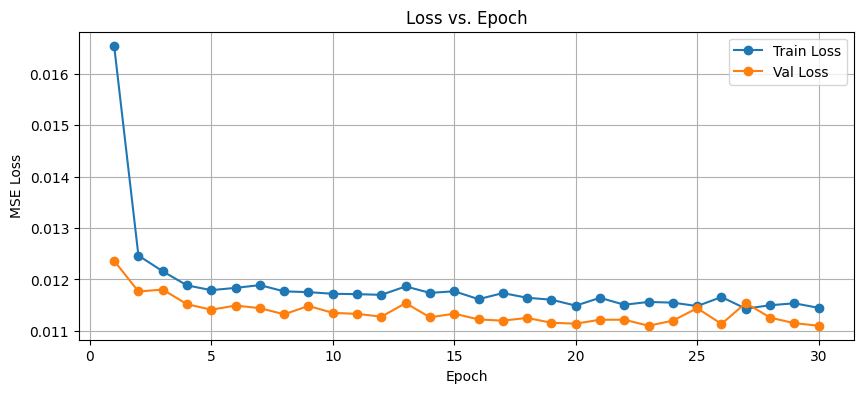

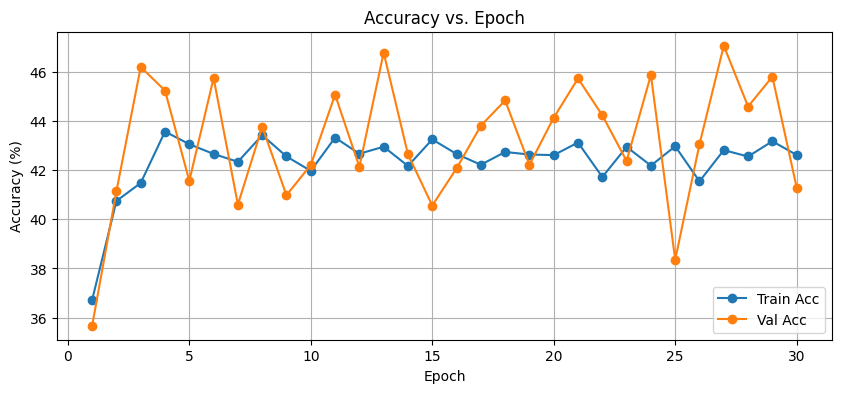

Visualizing predictions on validation examples...


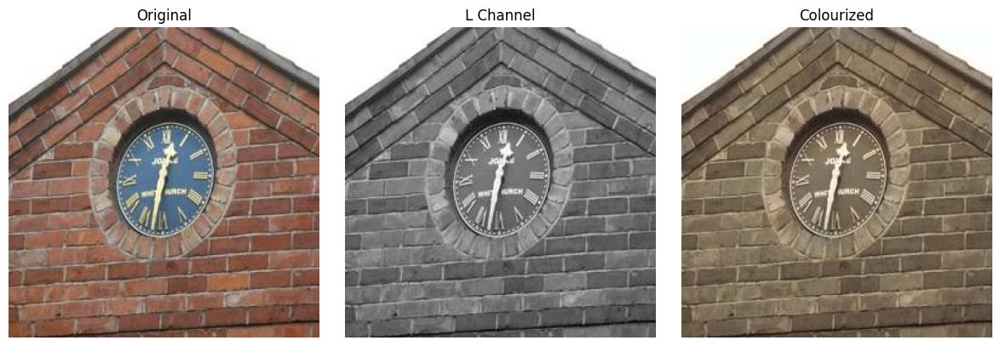

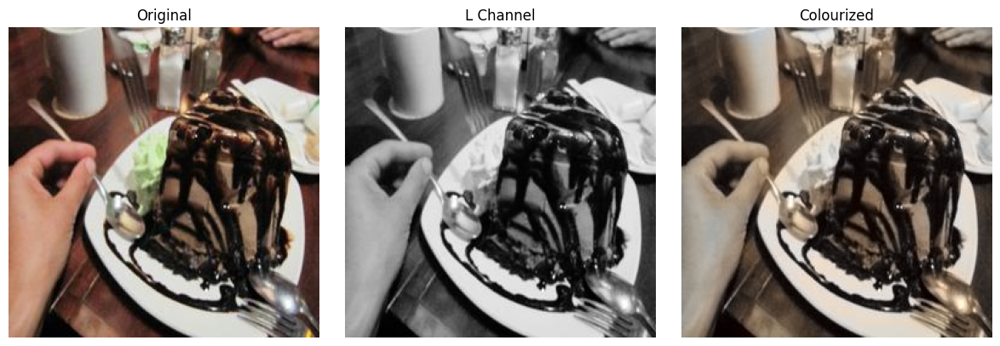

In [ ]:

train_dataset = LabColorizationDataset(
        npz_dir="/tmp/data/smalldataset/smalldatasetcolour_train"
    )
val_dataset = LabColorizationDataset(
        npz_dir="/tmp/data/smalldataset/smalldatasetcolour_val"
    )
net = ColorizationCNNTranspose()
train_colorizer(net, batch_size=32, num_epochs=30)
print("Visualizing predictions on validation examples...")
for idx in range(2):
        visualize_and_save(net, val_dataset, device=torch.device('cpu'), index=idx, save_path='/tmp')

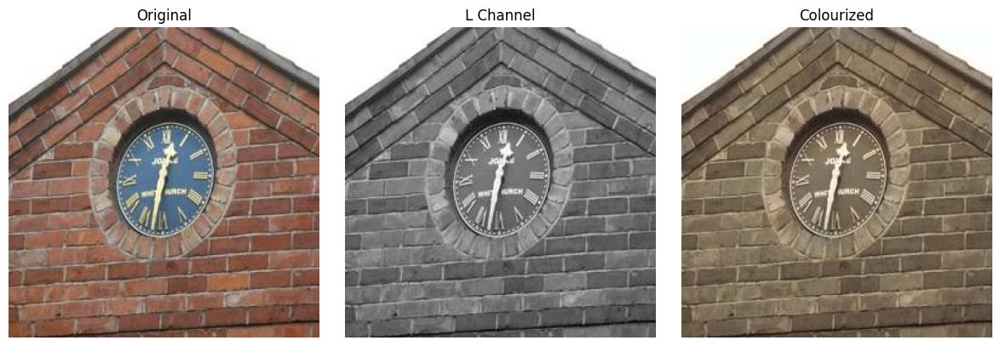

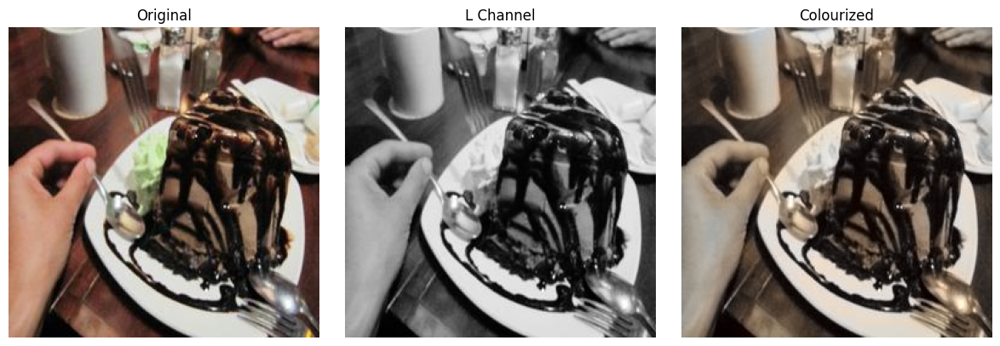

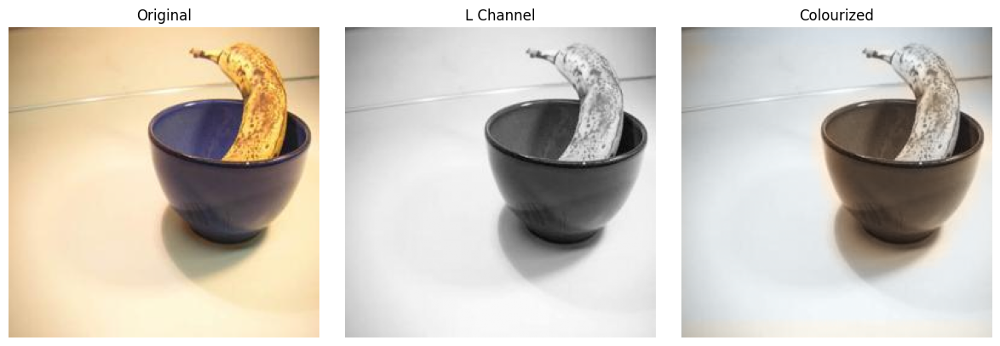

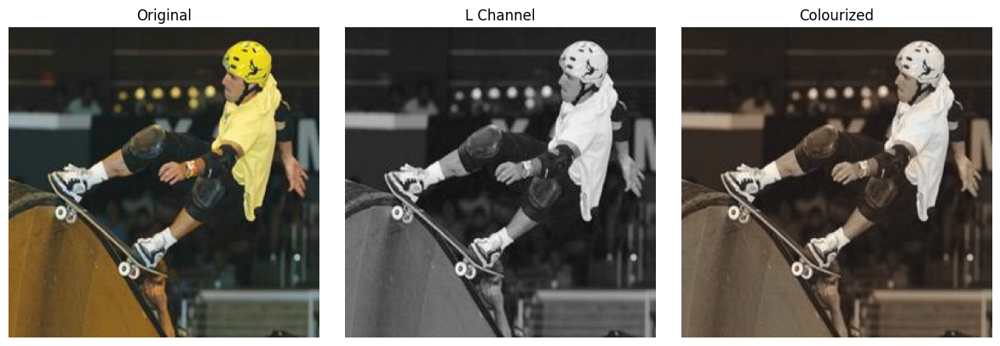

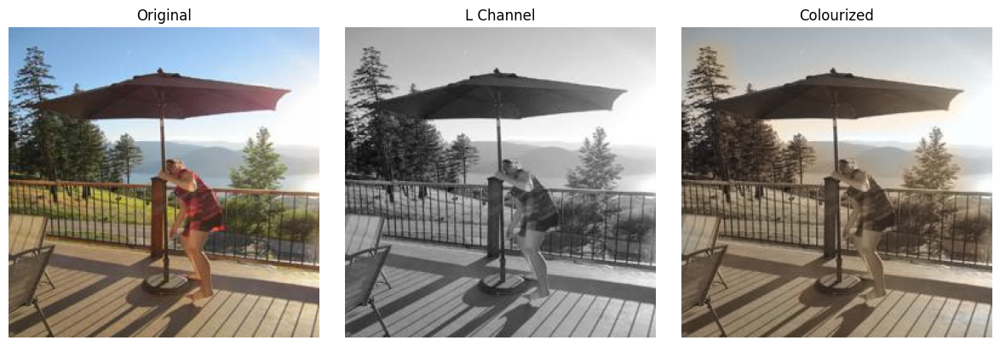

...

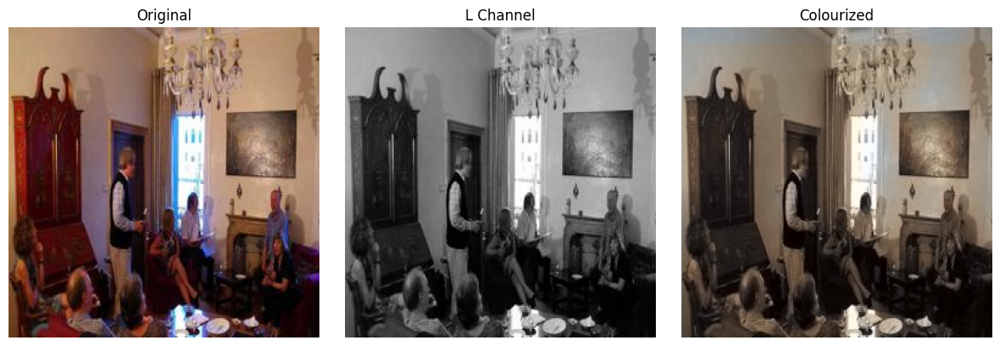

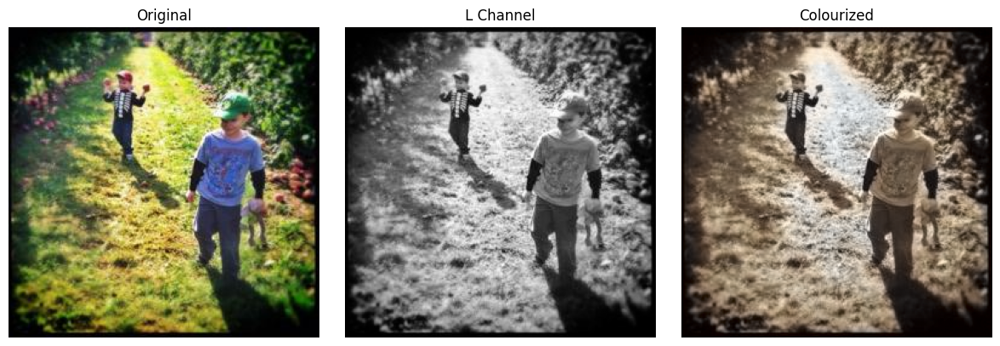

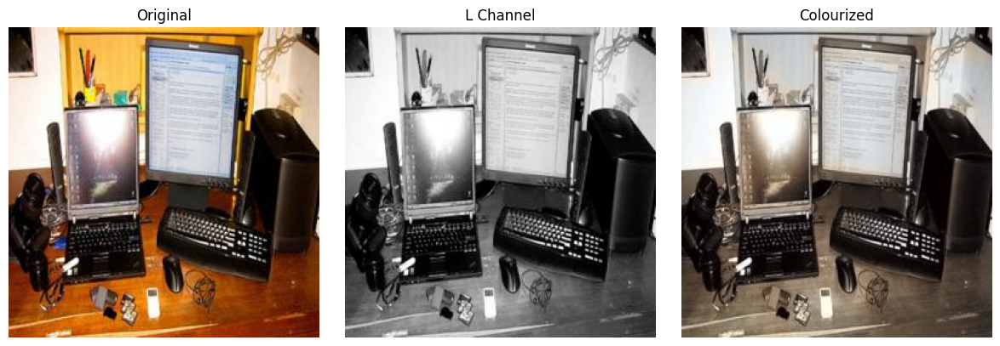

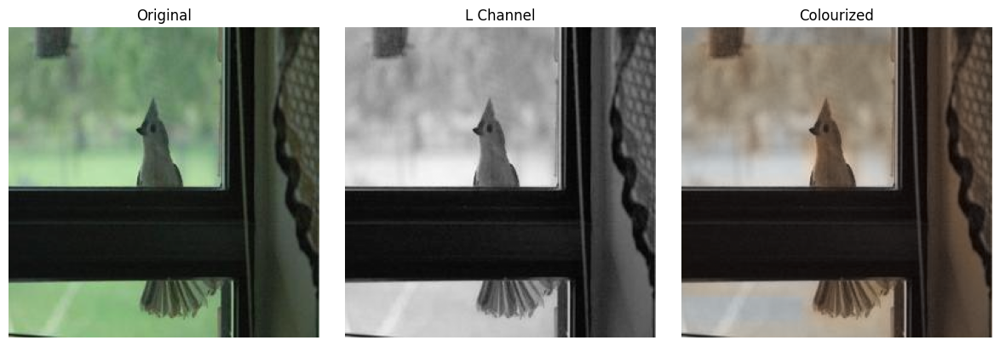

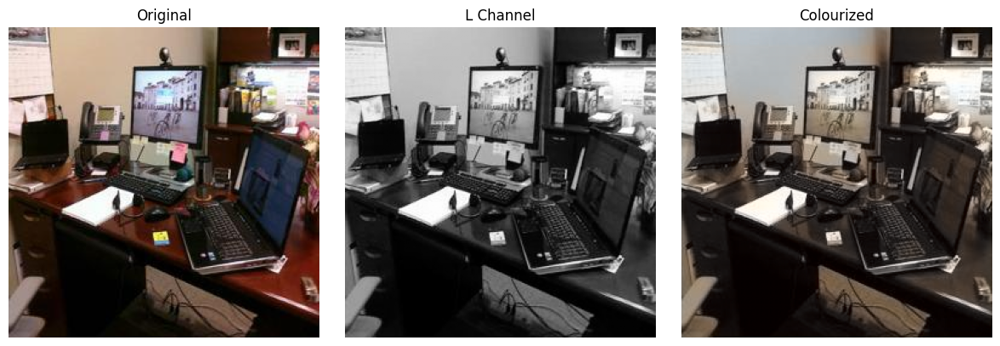

In [ ]:
for idx in range(30):
        visualize_and_save(net, val_dataset, device=torch.device('cpu'), index=idx, save_path='/tmp')



#Primary Model: U-Net for LAB Colorization


---



---


Architecture Overview
- **Input**: Grayscale images (L channel) of size 256×256
- **Output**: Color channels (ab channels) of size 256×256
- **Architecture**: U-Net with skip connections
- **Loss Function**: Mean Squared Error (MSE)
- **Optimizer**: Adam with learning rate scheduling

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
import cv2
from PIL import Image
import os
from pathlib import Path
import torch
import torch.nn as nn
import torch.nn.functional as F


In [ ]:
#ORIGINAL MODEL
"""
class UNetColorizer(nn.Module):

    U-Net for Image Colorization

    Architecture Details:
    - Input: Grayscale L channel (1×256×256)
    - Output: AB channels (2×256×256)
    - Encoder: 5 downsampling blocks (64, 128, 256, 512, 1024 channels)
    - Decoder: 4 upsampling blocks with skip connections
    - Skip connections

    def __init__(self, n_channels=1, n_classes=2, bilinear=True):
        super(UNetColorizer, self).__init__()
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.bilinear = bilinear

        #encoder
        self.inc = DoubleConv(n_channels, 64)
        self.down1 = Down(64, 128)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 512)
        factor = 2 if bilinear else 1
        self.down4 = Down(512, 1024 // factor)

        #decoder
        self.up1 = Up(1024, 512 // factor, bilinear)
        self.up2 = Up(512, 256 // factor, bilinear)
        self.up3 = Up(256, 128 // factor, bilinear)
        self.up4 = Up(128, 64, bilinear)

        #output layer
        self.outc = OutConv(64, n_classes)

        #use tanh activation for ab channels ???? maybe another one?
        self.tanh = nn.Tanh()

    def forward(self, x):
        #encoder - the 5 different channels
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)

        #decoder with skip connections
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)

        #output
        logits = self.outc(x)
        return self.tanh(logits)

def count_parameters(model):
    total_params = sum(p.numel() for p in model.parameters())
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    return total_params, trainable_params

model = UNetColorizer(n_channels=1, n_classes=2, bilinear=True)
total_params, trainable_params = count_parameters(model)

#print out the archetecture variables - for users
print("="*60)
print("U-NET COLORIZER ARCHITECTURE")
print("="*60)
print(f"Total parameters: {total_params:,}")
print(f"Trainable parameters: {trainable_params:,}")
print(f"Model size: {total_params * 4 / 1024**2:.2f} MB")
print("="*60)

#test the forward pass
test_input = torch.randn(1, 1, 256, 256)
with torch.no_grad():
    output = model(test_input)
    print(f"Input shape: {test_input.shape}")
    print(f"Output shape: {output.shape}")
    print(f"Output range: [{output.min():.3f}, {output.max():.3f}]")
print("="*60)
 """

In [ ]:
#ORIGINAL TRAIN
'''
from tqdm.notebook import tqdm

class LABDataset(torch.utils.data.Dataset):
    def __init__(self, directory):
        self.directory = directory
        self.files = [f for f in os.listdir(directory) if f.endswith('.npz')]

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file_path = os.path.join(self.directory, self.files[idx])
        data = np.load(file_path)

        L = data['L']
        ab = data['ab']

        # Fix L shape
        if L.ndim == 2:
            L = np.expand_dims(L, axis=0)  # (1, H, W)

        # Fix ab shape
        if ab.ndim == 3 and ab.shape[-1] == 2:  # (H, W, 2)
            ab = ab.transpose(2, 0, 1)  # → (2, H, W)

        L = torch.tensor(L, dtype=torch.float32)
        ab = torch.tensor(ab, dtype=torch.float32)

        return L, ab


# Dataset Paths
root_dir = "/tmp/data"
train_dir = os.path.join(root_dir, "train")
val_dir = os.path.join(root_dir, "val")
test_dir = os.path.join(root_dir, "test")

train_dataset = LABDataset(train_dir)
val_dataset = LABDataset(val_dir)
test_dataset = LABDataset(test_dir)

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False)

# Model Setup
model = UNetColorizer(n_channels=1, n_classes=2)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=1e-4)

# Training Function
def train(model, train_loader, val_loader, optimizer, criterion, device, epochs=20):
    for epoch in range(epochs):
        model.train()
        train_loss = 0.0
        for L, ab in tqdm(train_loader, desc=f"Epoch {epoch+1}/{epochs} - Training"):
            L, ab = L.to(device), ab.to(device)

            optimizer.zero_grad()
            output = model(L)
            loss = criterion(output, ab)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        val_loss = 0.0
        model.eval()
        with torch.no_grad():
            for L, ab in val_loader:
                L, ab = L.to(device), ab.to(device)
                output = model(L)
                loss = criterion(output, ab)
                val_loss += loss.item()

        print(f"Epoch {epoch+1}: Train Loss = {train_loss/len(train_loader):.4f} | Val Loss = {val_loss/len(val_loader):.4f}")

train(model, train_loader, val_loader, optimizer, criterion, device, epochs=20)

In [ ]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
from typing import Tuple

# Conditional U-Net Generator
class DoubleConv(nn.Module):
    def __init__(self, in_channels: int, out_channels: int, mid_channels=None):
        super().__init__()
        if mid_channels is None:
            mid_channels = out_channels
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(mid_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.double_conv(x)


class Down(nn.Module):
    def __init__(self, in_channels: int, out_channels: int):
        super().__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels),
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.maxpool_conv(x)


class Up(nn.Module):
    def __init__(self, in_channels: int, out_channels: int, bilinear: bool = True):
        super().__init__()
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
            self.conv = DoubleConv(in_channels, out_channels, in_channels // 2)
        else:
            self.up = nn.ConvTranspose2d(in_channels, in_channels // 2, kernel_size=2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1: torch.Tensor, x2: torch.Tensor) -> torch.Tensor:
        x1 = self.up(x1)
        diff_y = x2.size(2) - x1.size(2)
        diff_x = x2.size(3) - x1.size(3)
        x1 = F.pad(x1, [diff_x // 2, diff_x - diff_x // 2, diff_y // 2, diff_y - diff_y // 2])
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)


class OutConv(nn.Module):
    def __init__(self, in_channels: int, out_channels: int):
        super().__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.conv(x)


class UNetGenerator(nn.Module):
    """
    U-Net generator that maps L-channel (1×H×W) to ab-channels (2×H×W).
    """

    def __init__(self, n_channels: int = 1, n_classes: int = 2, bilinear: bool = True):
        super().__init__()
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.bilinear = bilinear

        self.inc = DoubleConv(n_channels, 64)
        self.down1 = Down(64, 128)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 512)
        factor = 2 if bilinear else 1
        self.down4 = Down(512, 1024 // factor)
        self.up1 = Up(1024, 512 // factor, bilinear)
        self.up2 = Up(512, 256 // factor, bilinear)
        self.up3 = Up(256, 128 // factor, bilinear)
        self.up4 = Up(128, 64, bilinear)
        self.outc = OutConv(64, n_classes)
        self.tanh = nn.Tanh()  # ab in [-1, 1]

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        logits = self.outc(x)
        return self.tanh(logits)


# PatchGAN Discriminator
class PatchDiscriminator(nn.Module):
    """
    PatchGAN discriminator that judges (L, ab) concatenated along channels.
    Input: 3×H×W (1 L + 2 ab)
    Output: patch-wise real/fake logits (no sigmoid).
    """

    def __init__(self, in_channels: int = 3, base_channels: int = 64):
        super().__init__()
        self.model = nn.Sequential(
            # (in) -> 64
            nn.Conv2d(in_channels, base_channels, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            # 64 -> 128
            nn.Conv2d(base_channels, base_channels * 2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(base_channels * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # 128 -> 256
            nn.Conv2d(base_channels * 2, base_channels * 4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(base_channels * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # 256 -> 512
            nn.Conv2d(base_channels * 4, base_channels * 8, kernel_size=4, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(base_channels * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # 512 -> 1 (logits map)
            nn.Conv2d(base_channels * 8, 1, kernel_size=4, stride=1, padding=1),
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.model(x)


def initialize_weights(module: nn.Module) -> None:
    for m in module.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)
            if getattr(m, "bias", None) is not None and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif isinstance(m, (nn.BatchNorm2d,)):
            nn.init.normal_(m.weight.data, 1.0, 0.02)
            nn.init.constant_(m.bias.data, 0.0)


In [ ]:
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt


class LABDataset(torch.utils.data.Dataset):
    def __init__(self, directory: str):
        self.directory = directory
        self.files = [f for f in os.listdir(directory) if f.endswith('.npz')]
        self.files.sort()

        self.l_scale = 'lab100'
        self.ab_scale = 'lab128'

        if len(self.files) > 0:
            probe = np.load(os.path.join(self.directory, self.files[0]))
            Lp = probe['L']
            abp = probe['ab']
            Lp_min = float(np.min(Lp))
            Lp_max = float(np.max(Lp))
            abp_min = float(np.min(abp))
            abp_max = float(np.max(abp))
            if Lp_max <= 1.5:
                self.l_scale = 'unit01'
            elif Lp_max > 150.0:
                self.l_scale = 'uint8'
            else:
                self.l_scale = 'lab100'
            if abp_max <= 1.5 and abp_min >= -1.5:
                self.ab_scale = 'unit11'
            elif abp_min >= 0.0 and abp_max <= 255.0:
                self.ab_scale = 'uint8ab'
            else:
                self.ab_scale = 'lab128'

    def __len__(self) -> int:
        return len(self.files)

    def _normalize(self, L: np.ndarray, ab: np.ndarray) -> tuple[torch.Tensor, torch.Tensor]:
        if L.ndim == 2:
            L = np.expand_dims(L, axis=0)
        if ab.ndim == 3 and ab.shape[-1] == 2:
            ab = ab.transpose(2, 0, 1)
        L_t = torch.tensor(L, dtype=torch.float32)
        ab_t = torch.tensor(ab, dtype=torch.float32)
        if self.l_scale == 'unit01':
            L_norm = L_t * 2.0 - 1.0
        elif self.l_scale == 'uint8':
            L_norm = (L_t / 255.0) * 2.0 - 1.0
        else:
            L_norm = (L_t / 50.0) - 1.0

        if self.ab_scale == 'unit11':
            ab_norm = ab_t
        elif self.ab_scale == 'uint8ab':
            ab_norm = (ab_t - 128.0) / 128.0
        else:
            ab_norm = ab_t / 128.0
        return L_norm, ab_norm

    def denorm_L(self, L_norm: torch.Tensor) -> torch.Tensor:
        if self.l_scale == 'unit01':
            return (L_norm + 1.0) * 0.5 * 100.0
        elif self.l_scale == 'uint8':
            return (L_norm + 1.0) * 0.5 * 100.0
        else:
            return (L_norm + 1.0) * 50.0

    def denorm_ab(self, ab_norm: torch.Tensor) -> torch.Tensor:
        if self.ab_scale == 'unit11':
            return ab_norm * 128.0
        elif self.ab_scale == 'uint8ab':
            return ab_norm * 128.0
        else:
            return ab_norm * 128.0

    def __getitem__(self, idx: int) -> tuple[torch.Tensor, torch.Tensor]:
        file_path = os.path.join(self.directory, self.files[idx])
        data = np.load(file_path)
        L = data['L']
        ab = data['ab']
        L_norm, ab_norm = self._normalize(L, ab)
        return L_norm, ab_norm


def set_requires_grad(module: nn.Module, requires_grad: bool) -> None:
    for p in module.parameters():
        p.requires_grad = requires_grad


def gan_targets_like(pred: torch.Tensor, is_real: bool, smoothing: float = 0.0) -> torch.Tensor:
    if is_real:
        target = 1.0 - smoothing
    else:
        target = 0.0
    return torch.full_like(pred, fill_value=target)


def denorm_for_vis(ds: LABDataset, L_norm: torch.Tensor, ab_norm: torch.Tensor) -> tuple[torch.Tensor, torch.Tensor]:
    L = ds.denorm_L(L_norm)
    ab = ds.denorm_ab(ab_norm)
    return L, ab


def lab_to_rgb_image(L: np.ndarray, ab: np.ndarray) -> np.ndarray:
    try:
        from skimage import color
        L = L.squeeze(0)
        lab = np.concatenate([L[None, ...], ab], axis=0).transpose(1, 2, 0)  # (H,W,3)
        lab[..., 0] = np.clip(lab[..., 0], 0.0, 100.0)
        lab[..., 1] = np.clip(lab[..., 1], -128.0, 127.0)
        lab[..., 2] = np.clip(lab[..., 2], -128.0, 127.0)
        rgb = color.lab2rgb(lab)
        rgb = np.clip(rgb, 0.0, 1.0)
        return rgb
    except Exception:
        g = np.clip(L / 100.0, 0.0, 1.0)
        return np.stack([g, g, g], axis=-1)


root_dir = "/tmp/data"
train_dir = os.path.join(root_dir, "train")
val_dir = os.path.join(root_dir, "val")
test_dir = os.path.join(root_dir, "test")

train_dataset = LABDataset(train_dir)
val_dataset = LABDataset(val_dir)
test_dataset = LABDataset(test_dir)

batch_size = 8
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2, pin_memory=torch.cuda.is_available())
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2, pin_memory=torch.cuda.is_available())

generator = UNetGenerator().to(device)
discriminator = PatchDiscriminator().to(device)

initialize_weights(generator)
initialize_weights(discriminator)

# Losses
adv_criterion = nn.BCEWithLogitsLoss()
recon_criterion = nn.L1Loss()

# Optimizers
lr_g = 2e-4
lr_d = 2e-4
beta1, beta2 = 0.5, 0.999
optim_G = optim.Adam(generator.parameters(), lr=lr_g, betas=(beta1, beta2))
optim_D = optim.Adam(discriminator.parameters(), lr=lr_d, betas=(beta1, beta2))

lambda_l1 = 75.0



Epoch 1/30:   0%|          | 0/574 [00:00<?, ?it/s]

Epoch 1: D=0.5942 | G=7.3238 | L1=6.0646


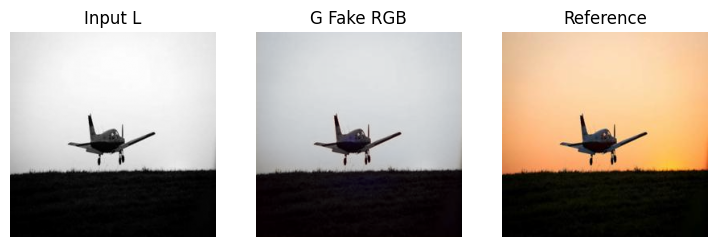

Epoch 2/30:   0%|          | 0/574 [00:00<?, ?it/s]

Epoch 2: D=0.5955 | G=7.6787 | L1=6.4035


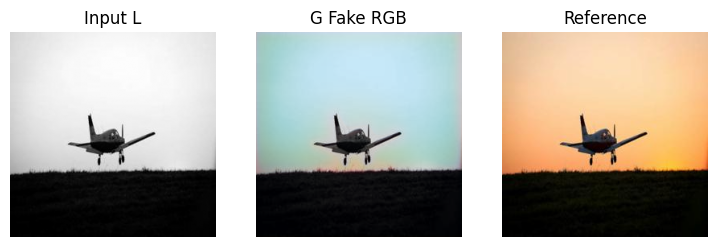

Epoch 3/30:   0%|          | 0/574 [00:00<?, ?it/s]

Epoch 3: D=0.6031 | G=7.6727 | L1=6.4429


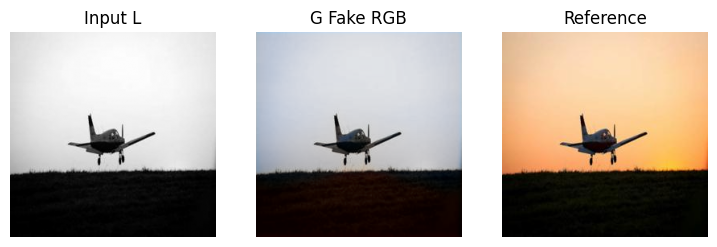

Epoch 4/30:   0%|          | 0/574 [00:00<?, ?it/s]

Epoch 4: D=0.6093 | G=7.6117 | L1=6.3864


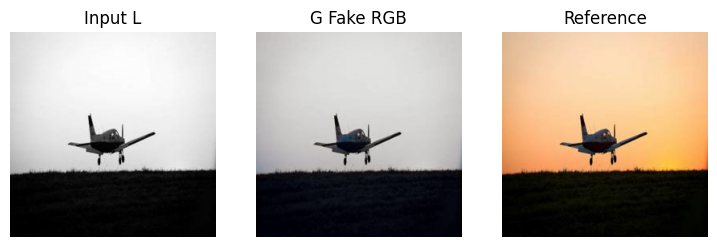

Epoch 5/30:   0%|          | 0/574 [00:00<?, ?it/s]

Epoch 5: D=0.6157 | G=7.6066 | L1=6.4107


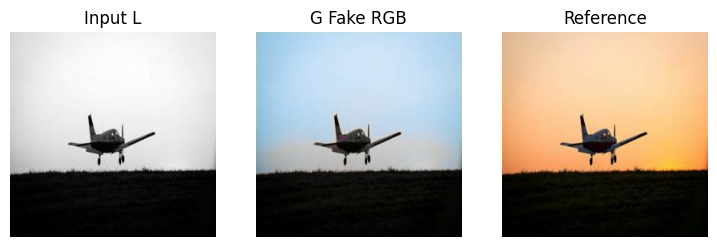

Epoch 6/30:   0%|          | 0/574 [00:00<?, ?it/s]

Epoch 6: D=0.5963 | G=7.6632 | L1=6.3877


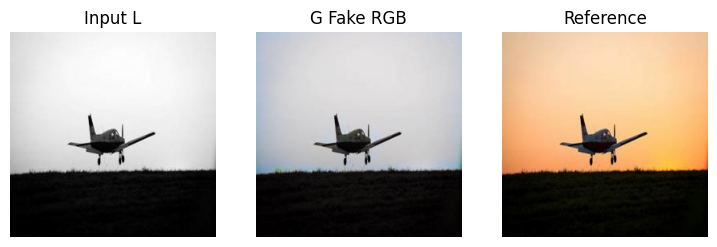

Epoch 7/30:   0%|          | 0/574 [00:00<?, ?it/s]

Epoch 7: D=0.5984 | G=7.7097 | L1=6.4391


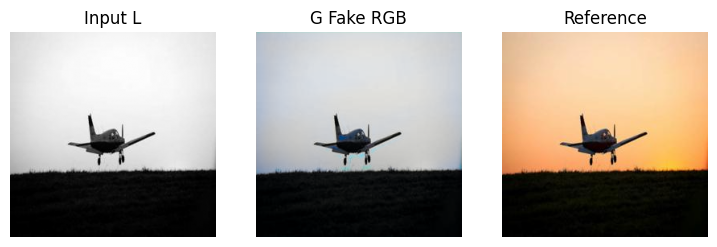

Epoch 8/30:   0%|          | 0/574 [00:00<?, ?it/s]

Epoch 8: D=0.6000 | G=7.6715 | L1=6.3846


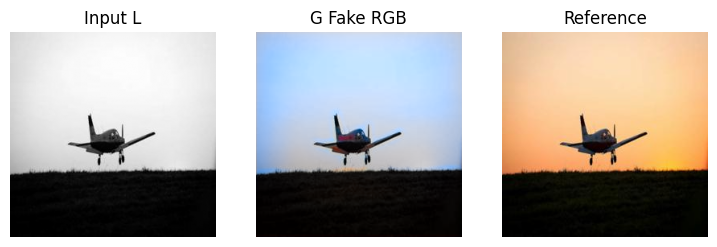

Epoch 9/30:   0%|          | 0/574 [00:00<?, ?it/s]

Epoch 9: D=0.6031 | G=7.6513 | L1=6.3870


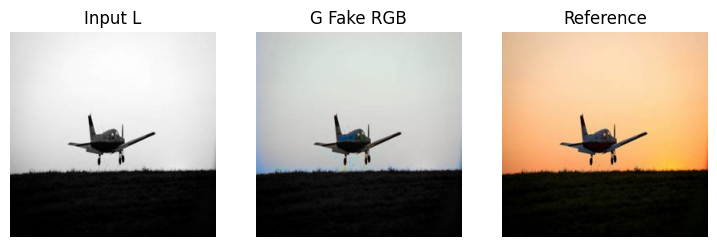

Epoch 10/30:   0%|          | 0/574 [00:00<?, ?it/s]

Epoch 10: D=0.5968 | G=7.6406 | L1=6.3750


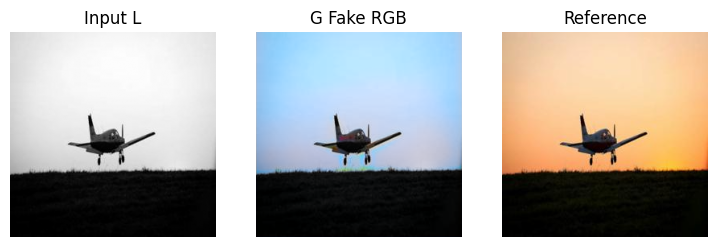

Epoch 11/30:   0%|          | 0/574 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:


def train_gan(num_epochs: int = 20, d_updates: int = 1, g_updates: int = 1, val_interval: int = 1):
    history = {"d_loss": [], "g_loss": [], "l1": []}
    for epoch in range(1, num_epochs + 1):
        generator.train()
        discriminator.train()
        running_d, running_g, running_l1 = 0.0, 0.0, 0.0

        for L_norm, ab_norm in tqdm(train_loader, desc=f"Epoch {epoch}/{num_epochs}"):
            L_norm = L_norm.to(device)
            ab_norm = ab_norm.to(device)

            #  Train Discriminator

            for _ in range(d_updates):
                set_requires_grad(discriminator, True)
                optim_D.zero_grad(set_to_none=True)

                real_pair = torch.cat([L_norm, ab_norm], dim=1)
                pred_real = discriminator(real_pair)
                real_targets = gan_targets_like(pred_real, is_real=True, smoothing=0.1)
                loss_real = adv_criterion(pred_real, real_targets)

                with torch.no_grad():
                    fake_ab = generator(L_norm)
                fake_pair = torch.cat([L_norm, fake_ab.detach()], dim=1)
                pred_fake = discriminator(fake_pair)
                fake_targets = gan_targets_like(pred_fake, is_real=False)
                loss_fake = adv_criterion(pred_fake, fake_targets)

                d_loss = (loss_real + loss_fake) * 0.5
                d_loss.backward()
                optim_D.step()

            #  Train Generator
            for _ in range(g_updates):
                set_requires_grad(discriminator, False)
                optim_G.zero_grad(set_to_none=True)

                gen_ab = generator(L_norm)
                gen_pair = torch.cat([L_norm, gen_ab], dim=1)
                pred_gen = discriminator(gen_pair)

                adv_loss = adv_criterion(pred_gen, gan_targets_like(pred_gen, is_real=True))
                l1_loss = recon_criterion(gen_ab, ab_norm) * lambda_l1
                g_loss = adv_loss + l1_loss

                g_loss.backward()
                optim_G.step()

            running_d += d_loss.item()
            running_g += g_loss.item()
            running_l1 += l1_loss.item()

        n_batches = max(1, len(train_loader))
        print(f"Epoch {epoch}: D={running_d/n_batches:.4f} | G={running_g/n_batches:.4f} | L1={running_l1/n_batches:.4f}")
        history["d_loss"].append(running_d / n_batches)
        history["g_loss"].append(running_g / n_batches)
        history["l1"].append(running_l1 / n_batches)

        if epoch % val_interval == 0 and len(val_loader) > 0:
            generator.eval()
            with torch.no_grad():
                Lb, ab_gtb = next(iter(val_loader))
                Lb = Lb.to(device)
                fake_ab = generator(Lb).cpu()
                Lb_cpu = Lb.cpu()
                L_den, ab_den = denorm_for_vis(val_dataset, Lb_cpu[0], fake_ab[0])
                rgb = lab_to_rgb_image(L_den.numpy(), ab_den.numpy())
                Lgt_den, abgt_den = denorm_for_vis(val_dataset, Lb_cpu[0], ab_gtb[0])
                rgb_ref = lab_to_rgb_image(Lgt_den.numpy(), abgt_den.numpy())

                plt.figure(figsize=(9, 3))
                plt.subplot(1, 3, 1)
                plt.title("Input L")
                plt.imshow(np.clip(L_den.squeeze(0).numpy() / 100.0, 0.0, 1.0), cmap='gray')
                plt.axis('off')
                plt.subplot(1, 3, 2)
                plt.title("G Fake RGB")
                plt.imshow(rgb)
                plt.axis('off')
                plt.subplot(1, 3, 3)
                plt.title("Reference")
                plt.imshow(rgb_ref)
                plt.axis('off')
                plt.show()

    return history

history = train_gan(num_epochs=30)


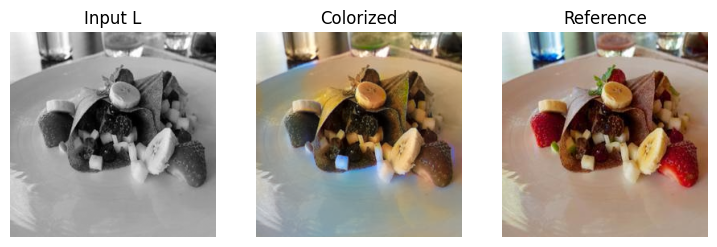

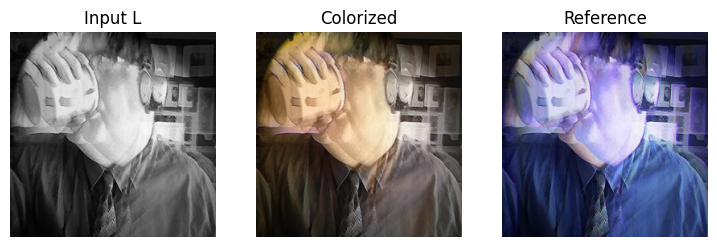

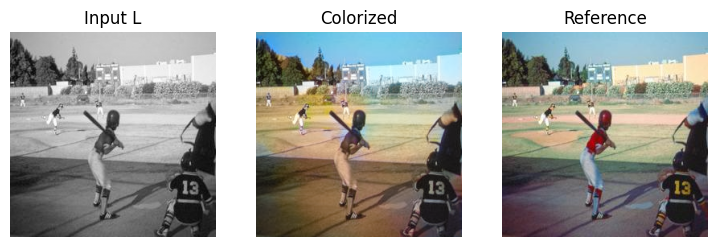

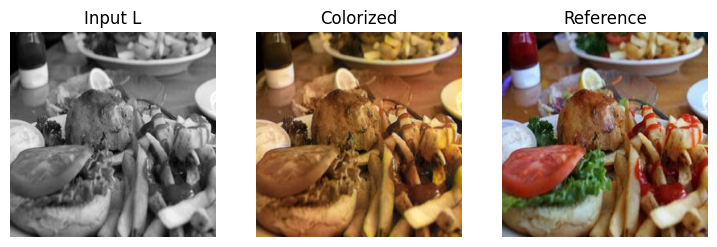

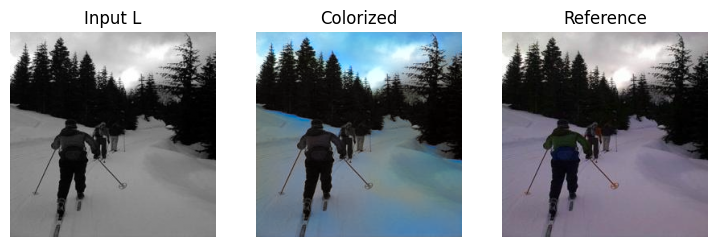

...

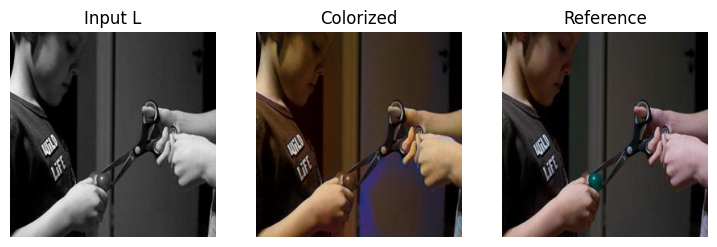

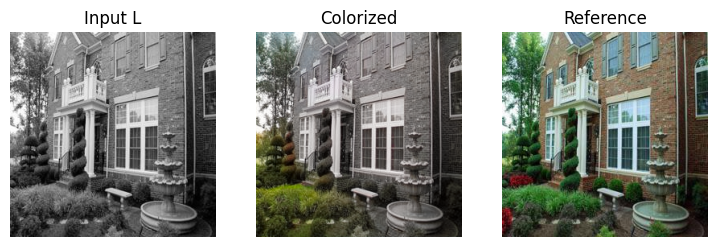

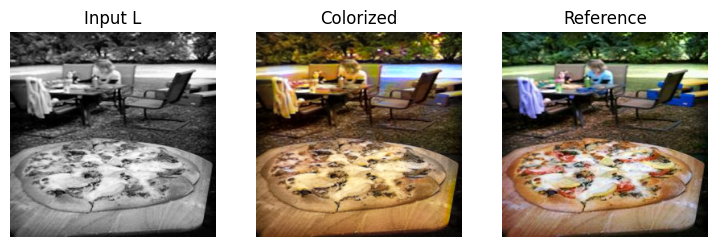

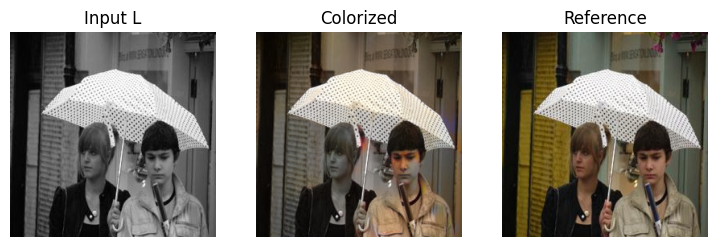

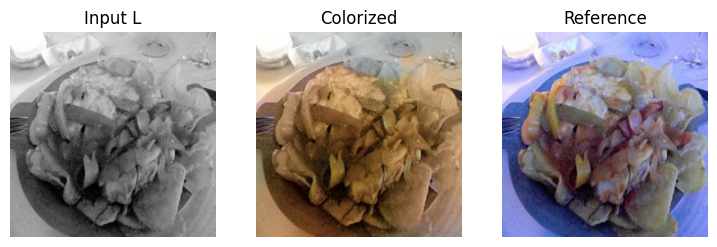

In [ ]:
# Final inference on test image(s)
from pathlib import Path

@torch.no_grad()
def colorize_and_show(n_samples: int = 1):
    generator.eval()
    if len(test_dataset) == 0:
        print("Test set is empty.")
        return
    n = min(n_samples, len(test_dataset))
    for i in range(n):
        L_norm, ab_norm_gt = test_dataset[i]
        L_in = L_norm.unsqueeze(0).to(device)
        fake_ab = generator(L_in).cpu()[0]
        L_den, ab_den = denorm_for_vis(test_dataset, L_norm, fake_ab)
        rgb = lab_to_rgb_image(L_den.numpy(), ab_den.numpy())

        plt.figure(figsize=(9, 3))
        plt.subplot(1, 3, 1)
        plt.title("Input L")
        plt.imshow(np.clip((L_den.squeeze(0).numpy()) / 100.0, 0.0, 1.0), cmap='gray')
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.title("Colorized")
        plt.imshow(rgb)
        plt.axis('off')

        try:
            L_gt, ab_gt = test_dataset[i]
            Ld_gt, abd_gt = denorm_for_vis(test_dataset, L_gt, ab_gt)
            ref = lab_to_rgb_image(Ld_gt.numpy(), abd_gt.numpy())
            plt.subplot(1, 3, 3)
            plt.title("Reference")
            plt.imshow(ref)
            plt.axis('off')
        except Exception:
            pass
        plt.show()

colorize_and_show(n_samples=30)



In [ ]:
torch.save(generator.state_dict(), "generator_final.pth")
torch.save(discriminator.state_dict(), "discriminator_final.pth")
print("Model weights saved!")

Model weights saved!


Saving Model